# Jakub Kasperski

Two code blocks below are from https://github.com/WojtAcht/agh-stochastic-ml/blob/main/lab2/instructions.md

In [1]:
import numpy as np
from abc import ABC, abstractmethod

class Problem(ABC):
    @abstractmethod
    def __call__(self, x: np.ndarray) -> float:
        """Compute the function value at point x."""
        raise NotImplementedError
    
    @abstractmethod
    def grad(self, x: np.ndarray) -> np.ndarray:
        """Compute the gradient at point x."""
        raise NotImplementedError

class Sphere(Problem):
    def __call__(self, x: np.ndarray) -> float:
        return np.sum(x**2)
    
    def grad(self, x: np.ndarray) -> np.ndarray:
        return 2 * x

class Rosenbrock(Problem):
    def __call__(self, x: np.ndarray) -> float:
        return np.sum(100.0 * (x[1:] - x[:-1]**2)**2 + (1 - x[:-1])**2)
    
    def grad(self, x: np.ndarray) -> np.ndarray:
        grad = np.zeros_like(x)
        n = x.size
        grad[0] = -400 * x[0] * (x[1] - x[0]**2) - 2 * (1 - x[0])
        for i in range(1, n - 1):
            grad[i] = 200 * (x[i] - x[i-1]**2) - 400 * x[i] * (x[i+1] - x[i]**2) - 2 * (1 - x[i])
        grad[-1] = 200 * (x[-1] - x[-2]**2)
        return grad

class Rastrigin(Problem):
    def __call__(self, x: np.ndarray) -> float:
        A = 10
        n = x.size
        return A * n + np.sum(x**2 - A * np.cos(2 * np.pi * x))
    
    def grad(self, x: np.ndarray) -> np.ndarray:
        A = 10
        return 2 * x + 2 * np.pi * A * np.sin(2 * np.pi * x)


In [3]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go

def prepare_mesh_grid(
    problem: Problem,
    bounds: tuple[float, float] = (-5.0, 5.0),
    grid_size: int = 50,
) -> tuple[np.ndarray, np.ndarray, np.ndarray, np.ndarray, np.ndarray]:
    x_vals = np.linspace(bounds[0], bounds[1], grid_size)
    y_vals = np.linspace(bounds[0], bounds[1], grid_size)
    X, Y = np.meshgrid(x_vals, y_vals)

    Z = np.zeros_like(X)
    for i in range(grid_size):
        for j in range(grid_size):
            xy = np.array([X[i, j], Y[i, j]])
            Z[i, j] = problem(xy)

    return X, Y, Z, x_vals, y_vals


def plot_3d_surface(
    problem: Problem,
    grid_size: int = 50,
):
    X, Y, Z, _, _ = prepare_mesh_grid(problem=problem, grid_size=grid_size)

    fig = plt.figure(figsize=(8, 6))
    ax = fig.add_subplot(111, projection="3d")
    surf = ax.plot_surface(X, Y, Z, cmap="viridis", edgecolor="none")

    ax.set_title(problem.__class__.__name__)
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.set_zlabel("f(x, y)")

    fig.colorbar(surf, shrink=0.5, aspect=10)
    plt.tight_layout()
    plt.show()

def plot_contour_and_paths(
    problem: Problem,
    paths: list[np.ndarray],
    grid_size: int = 200,
    title: str = "",
):
    """
    Create an interactive contour plot of a 2D function and overlay multiple optimization paths.

    Args:
        problem: An instance of a Problem class.
        paths: List of numpy arrays; each array is of shape (epochs, 2) containing an optimization trajectory.
        title: Title for the plot.
    """
    _, _, Z, x_vals, y_vals = prepare_mesh_grid(problem, grid_size=grid_size)

    fig = go.Figure(
        data=go.Contour(
            x=x_vals,
            y=y_vals,
            z=Z,
            colorscale="Viridis",
            contours=dict(showlines=False),
            colorbar=dict(title="Function Value"),
        )
    )

    colors = ['red', 'blue', 'green', 'purple', 'orange', 'cyan', 'magenta', 'yellow', 'pink', 'brown']
    
    for idx, path in enumerate(paths):
        color_idx = idx % len(colors)
        fig.add_trace(
            go.Scatter(
                x=path[:, 0],
                y=path[:, 1],
                mode="lines+markers",
                marker=dict(size=4),
                line=dict(width=2, color=colors[color_idx]),
                name=f"Run {idx+1}",
                showlegend=True,
            )
        )

    fig.update_layout(
        title=title, xaxis_title="x", yaxis_title="y", width=800, height=700,
        legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
    )

    fig.show()

## 1. Getting familiar with optimization test problems

In [5]:
sphere = Sphere()
rosenbrock = Rosenbrock()
rastrigin = Rastrigin()

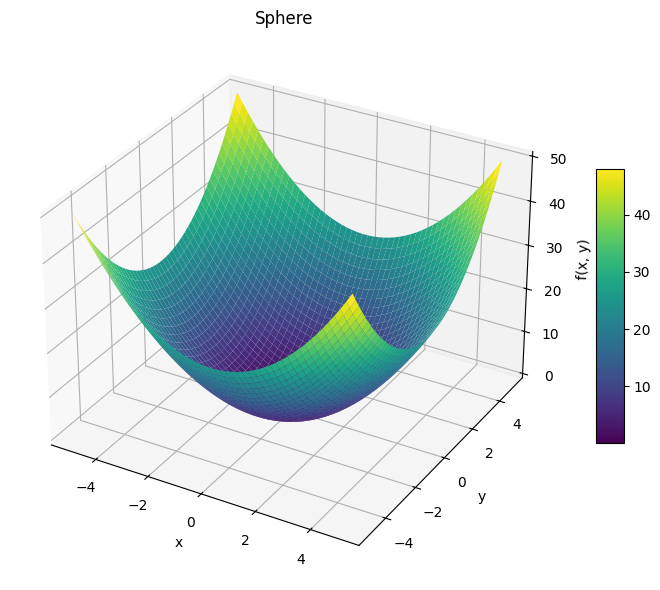

In [6]:
plot_3d_surface(sphere)

In [9]:
plot_contour_and_paths(sphere, [])

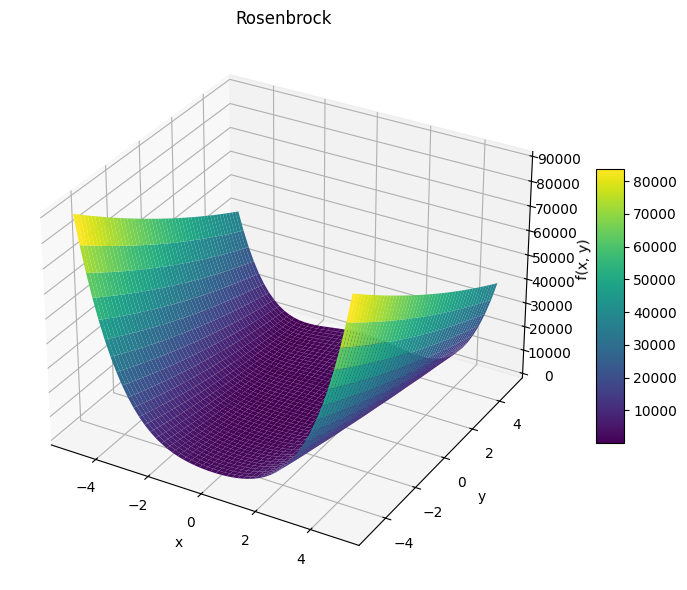

In [7]:
plot_3d_surface(rosenbrock)

In [10]:
plot_contour_and_paths(rosenbrock, [])

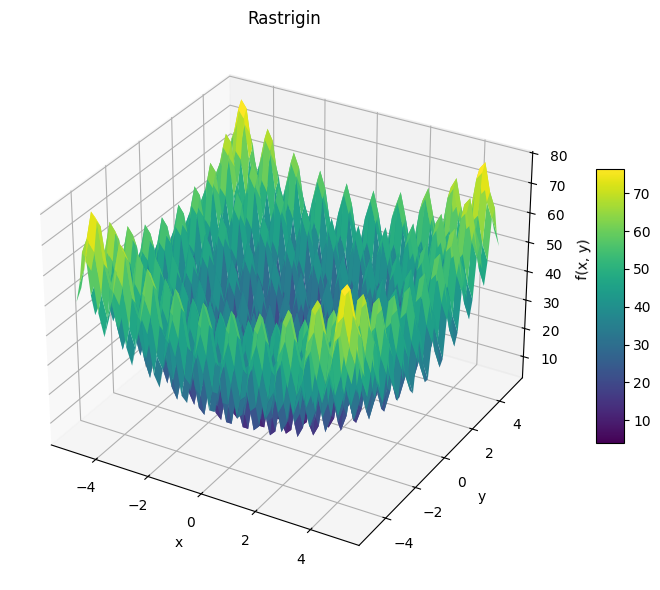

In [8]:
plot_3d_surface(rastrigin)

In [11]:
plot_contour_and_paths(rastrigin, [])

I think that sphere would be the easiest and rastrigin would be the hardest. Once we hit the local minimum, we are not getting out (at least using gradient decent)

## 2. Momentum method

In [25]:
def momentum(problem: Problem, initial_solution: np.ndarray, 
             alpha: float, beta: float, number_of_epochs: int): 
    
    velocity = 0
    sol = initial_solution
    function_values = [problem(sol)]
    velocity_norm_tab = [np.linalg.norm(velocity)]
    
    for epoch in range(number_of_epochs):
        velocity = beta * velocity + alpha * problem.grad(sol)
        sol -= velocity
        function_values.append(problem(sol))
        velocity_norm_tab.append(np.linalg.norm(velocity))
    
    return sol, function_values, velocity_norm_tab

## 3. Experiments with Momentum

In [40]:
_, function_values, velocity_norm_tab = momentum(problem = sphere, 
                                                 initial_solution = np.array([2.0, 2.0]),
                                                 alpha = 0.01,
                                                 beta = 0.9,
                                                 number_of_epochs = 100)

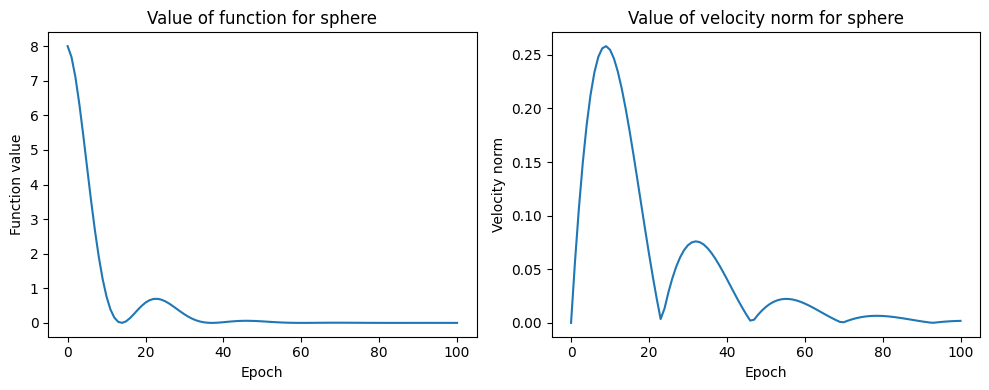

In [41]:
_, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 4))

problem_name = "sphere"

ax1.plot(function_values)
ax1.set_xlabel("Epoch")
ax1.set_ylabel("Function value")
ax1.set_title(f"Value of function for {problem_name}")

ax2.plot(velocity_norm_tab)
ax2.set_xlabel("Epoch")
ax2.set_ylabel("Velocity norm")
ax2.set_title(f"Value of velocity norm for {problem_name}")

plt.tight_layout()
plt.show()

In [51]:
_, function_values, velocity_norm_tab = momentum(problem = rosenbrock, 
                                                 initial_solution = np.array([2.0, 2.0]),
                                                 alpha = 0.001,
                                                 beta = 0.9,
                                                 number_of_epochs = 100)

_, function_values2, velocity_norm_tab2 = momentum(problem = rosenbrock, 
                                                 initial_solution = np.array([2.0, 2.0]),
                                                 alpha = 0.0001,
                                                 beta = 0.9,
                                                 number_of_epochs = 100)

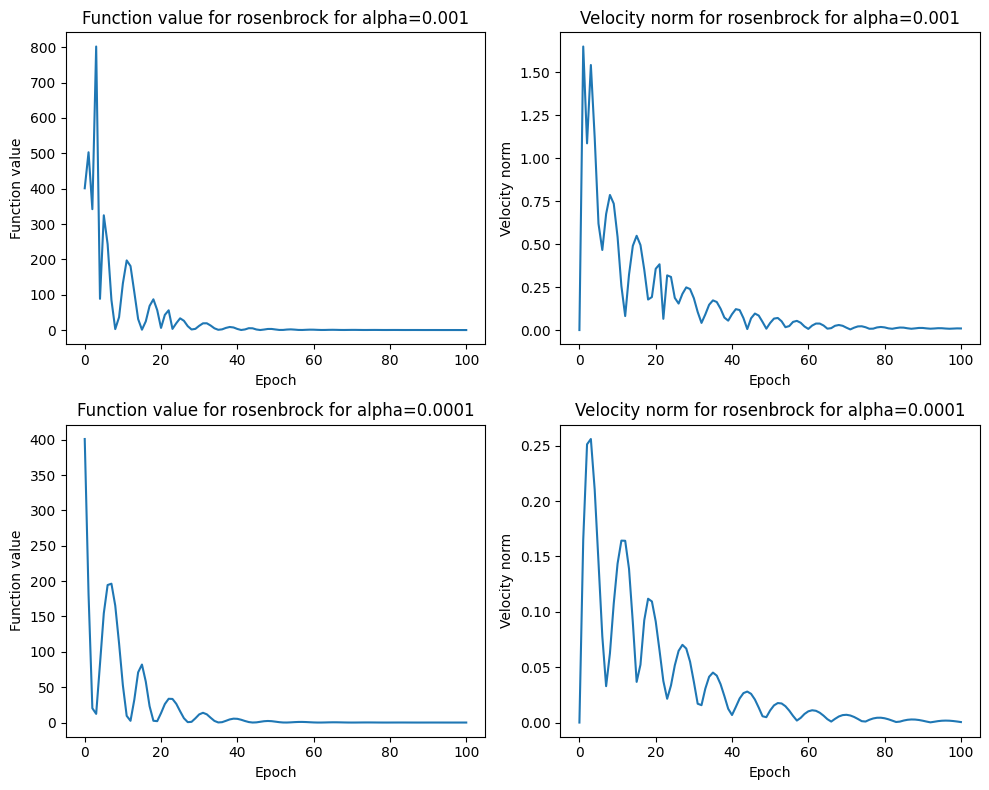

In [52]:
_, (ax1, ax2) = plt.subplots(2, 2, figsize=(10, 8))

problem_name = "rosenbrock"

ax1[0].plot(function_values)
ax1[0].set_xlabel("Epoch")
ax1[0].set_ylabel("Function value")
ax1[0].set_title(f"Function value for {problem_name} for alpha=0.001")

ax1[1].plot(velocity_norm_tab)
ax1[1].set_xlabel("Epoch")
ax1[1].set_ylabel("Velocity norm")
ax1[1].set_title(f"Velocity norm for {problem_name} for alpha=0.001")

ax2[0].plot(function_values2)
ax2[0].set_xlabel("Epoch")
ax2[0].set_ylabel("Function value")
ax2[0].set_title(f"Function value for {problem_name} for alpha=0.0001")

ax2[1].plot(velocity_norm_tab2)
ax2[1].set_xlabel("Epoch")
ax2[1].set_ylabel("Velocity norm")
ax2[1].set_title(f"Velocity norm for {problem_name} for alpha=0.0001")

plt.tight_layout()
plt.show()

In [46]:
print(f"Best function value for {problem_name} with alpha=0.001 is  {min(function_values)}")
print(f"Best function value for {problem_name} with alpha=0.0001 is {min(function_values2)}")

Best function value for rosenbrock with alpha=0.001 is  0.2522664236453219
Best function value for rosenbrock with alpha=0.0001 is 0.019434742319305486


In [53]:
_, function_values, velocity_norm_tab = momentum(problem=rastrigin,
                                                 initial_solution=np.array([2.0, 2.0]),
                                                 alpha=0.001,
                                                 beta=0.9,
                                                 number_of_epochs=100)

_, function_values2, velocity_norm_tab2 = momentum(problem=rastrigin,
                                                   initial_solution=np.array([2.0, 2.0]),
                                                   alpha=0.0001,
                                                   beta=0.9,
                                                   number_of_epochs=100)

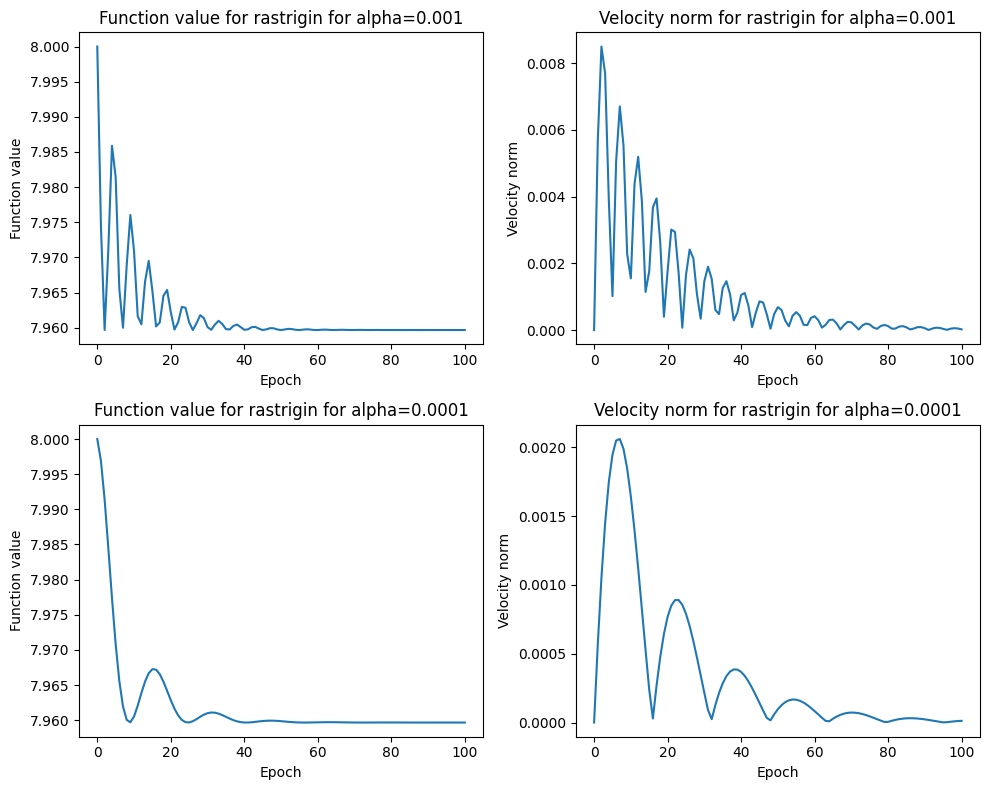

In [54]:
_, (ax1, ax2) = plt.subplots(2, 2, figsize=(10, 8))

problem_name = "rastrigin"

ax1[0].plot(function_values)
ax1[0].set_xlabel("Epoch")
ax1[0].set_ylabel("Function value")
ax1[0].set_title(f"Function value for {problem_name} for alpha=0.001")

ax1[1].plot(velocity_norm_tab)
ax1[1].set_xlabel("Epoch")
ax1[1].set_ylabel("Velocity norm")
ax1[1].set_title(f"Velocity norm for {problem_name} for alpha=0.001")

ax2[0].plot(function_values2)
ax2[0].set_xlabel("Epoch")
ax2[0].set_ylabel("Function value")
ax2[0].set_title(f"Function value for {problem_name} for alpha=0.0001")

ax2[1].plot(velocity_norm_tab2)
ax2[1].set_xlabel("Epoch")
ax2[1].set_ylabel("Velocity norm")
ax2[1].set_title(f"Velocity norm for {problem_name} for alpha=0.0001")

plt.tight_layout()
plt.show()

In [55]:
print(f"Best function value for {problem_name} with alpha=0.001 is  {min(function_values)}")
print(f"Best function value for {problem_name} with alpha=0.0001 is {min(function_values2)}")

Best function value for rastrigin with alpha=0.001 is  7.959662385178802
Best function value for rastrigin with alpha=0.0001 is 7.959662387330283


High velocity means that function is going fast into (a local) minimum \
When velocity is decreasing function values typically goes up, which means we are going in the opposite way of gradient \
Velocity and convergence speed are negatively correlated 

For a rastrigin problem lower alpha found an insignificantly better solution \
For a rosenbrock problem lower found a worse solution \
Different alpha for different problems!

## 4. Momentum Hyperparameters

In [59]:
beta_tab = [0.5, 0.75, 0.9, 0.95, 0.99]
outputs = []
for beta in beta_tab:
    outputs.append(momentum(problem = rosenbrock, 
                           initial_solution = np.array([2.0, 2.0]),
                           alpha = 0.0001,
                           beta = beta,
                           number_of_epochs = 100))

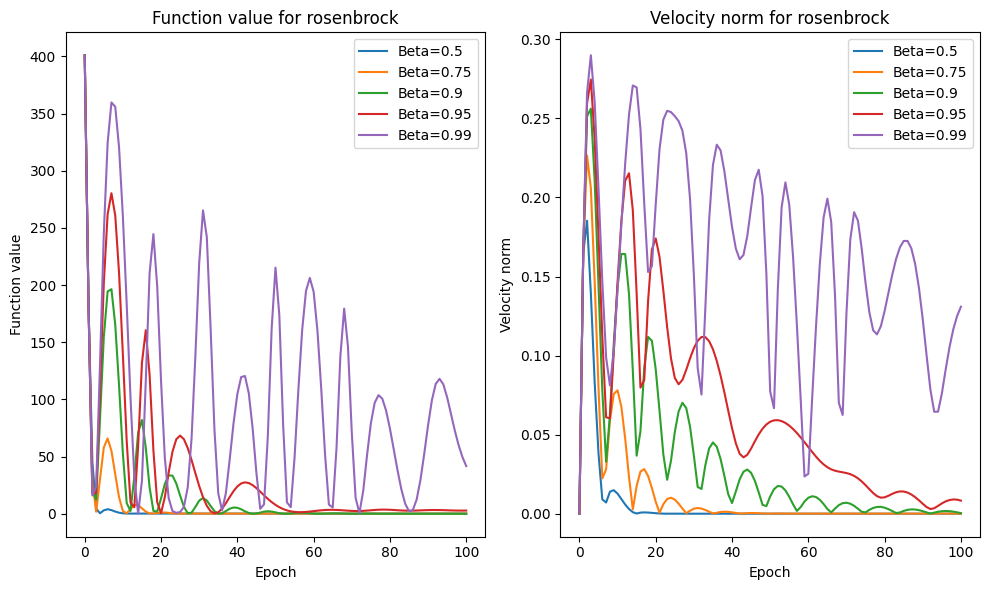

In [63]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 6))

for i, output in enumerate(outputs):
    ax1.plot(output[1], label=f"Beta={beta_tab[i]}")
    ax2.plot(output[2], label=f"Beta={beta_tab[i]}")

ax1.set_title("Function value for rosenbrock")
ax1.set_xlabel("Epoch")
ax1.set_ylabel("Function value")
ax1.legend()

ax2.set_title("Velocity norm for rosenbrock")
ax2.set_xlabel("Epoch")
ax2.set_ylabel("Velocity norm")
ax2.legend()

plt.tight_layout()
plt.show()

In [65]:
for i, beta in enumerate(beta_tab):
    print(f"Best function value for rosenbrock with beta={beta} is  {min(outputs[i][1])}")

Best function value for rosenbrock with beta=0.5 is  0.21091183135239464
Best function value for rosenbrock with beta=0.75 is  0.18293566334800565
Best function value for rosenbrock with beta=0.9 is  0.019434742319305486
Best function value for rosenbrock with beta=0.95 is  0.39704232098461323
Best function value for rosenbrock with beta=0.99 is  0.1388547704188696


Beta=0.99 is too big. There is no stability there \
Beta=0.5 converges the fastest, but it did not find the best solution. If we have limited computational resources or time, it would be still fine \
Beta=0.9 is the best. It has found the best solution and was pretty stable


## 5. Implementing Adam

In [68]:
def adam(problem: Problem, initial_solution: np.ndarray, 
         alpha: float, beta1: float, beta2: float, 
         number_of_epochs: int, epsilon: float = 1e-8):
    
    sol = initial_solution
    function_values = [problem(sol)]
    m1 = 0
    velocity = 0
    for i in range(number_of_epochs):
        m1 = beta1 * m1 + (1 - beta1) * problem.grad(sol)
        velocity = beta2 * velocity + (1 - beta2) * (problem.grad(sol) ** 2)
        m2 = m1 / (1 - beta1)
        v2 = velocity / (1 - beta2)
        sol = sol - (alpha * m2) / (np.sqrt(v2) + epsilon)
        function_values.append(problem(sol))
        
    return sol , function_values

## 6. Comparing Adam with Momentum

In [71]:
_, function_values_adam = adam(problem=sphere, initial_solution = np.array([2.0, 2.0]), 
                               alpha = 0.01, beta1 = 0.9, beta2 = 0.999, 
                               number_of_epochs = 100, epsilon = 1e-8)

_, function_values_momentum, _ = momentum(problem = sphere, 
                                          initial_solution = np.array([2.0, 2.0]),
                                          alpha = 0.01,
                                          beta = 0.9,
                                          number_of_epochs = 100)

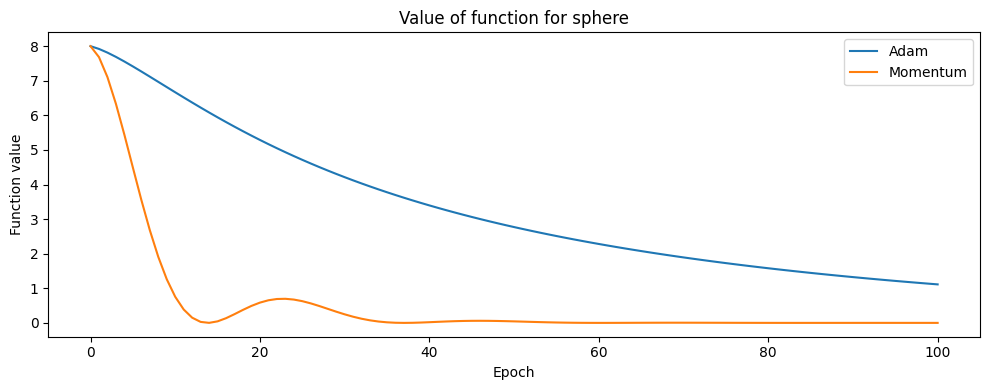

In [73]:
_, ax = plt.subplots(figsize=(10, 4))

problem_name = "sphere"

ax.plot(function_values_adam, label="Adam")
ax.plot(function_values_momentum, label="Momentum")

ax.legend()
ax.set_xlabel("Epoch")
ax.set_ylabel("Function value")
ax.set_title(f"Value of function for {problem_name}")


plt.tight_layout()
plt.show()

In [ ]:
plot_contour_and_paths()